In [1]:
%matplotlib inline

import setGPU

import os, h5py
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from matplotlib.colors import LogNorm, Normalize

import glob

setGPU: Setting GPU to: 0


/usr/local/lib/python3.5/dist-packages/h5py/__init__.py:34: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
def loadModel(name, weights=False):
    '''
    Adapted from Kaustuv Datta and Jayesh Mahapatra's CaloImageMacros.
    Loads models from json file.
    :parameter name: name of the json file.
    :type name: str
    :parameter weights: whether or not to load the weights.
    :type weights: bool
    :return: loaded model.
    '''
    from keras.models import model_from_json
    json_file = open('%s' % name, 'r')
    loaded = json_file.read()
    json_file.close()

    model = model_from_json(loaded)

    # load weights into new model
    if weights == True:
        model.load_weights('%s.h5' % name)
    # print(model.summary())

    #print("Loaded model from disk")
    return model

In [3]:
n_samples = 200

f = h5py.File('/bigdata/shared/HGCAL_data/new/all_noPU.h5', 'r')
X = np.asarray(f['X'])
X = X.squeeze()

latent_space=100
noise = np.random.normal(0, 1, (n_samples, latent_space))

In [4]:
def plotZ(X, generated_images, epoch = ''):
    # Plot sum over Z axis:
    x = np.arange(55)
    y_real = np.sum(X[0:n_samples-1], axis=(0, 1, 2))
    y_fake = np.sum(generated_images, axis=(0, 1, 2))
    plt.plot(x, y_real, color="green", label="real", alpha=0.8)
    plt.plot(x, y_fake, color="orange", label="fake", alpha=0.8)
    plt.xlabel("Position over the z axis", size=16)
    plt.ylabel("Energy sum (GeV)", size=16)
    plt.title("Total energy deposited along the z axis, epoch " + str(epoch), size=16)
    plt.legend()
    plt.show()

In [5]:
def plotX(X, generated_images, epoch=''):
    # Plot sum over X axis:
    x = np.arange(16)
    y_real = np.sum(X[0:n_samples-1], axis=(0, 2, 3))
    y_fake = np.sum(generated_images, axis=(0, 2, 3))
    plt.plot(x, y_real, color="green", label="real", alpha=0.9)
    plt.plot(x, y_fake, color="orange", label="fake", alpha=0.9)
    plt.xlabel("Position over the x axis", size=16)
    plt.ylabel("Energy sum (GeV)", size=16)
    plt.title("Total energy deposited along the x axis, epoch " + str(epoch), size=16)
    plt.legend()
    plt.show()

In [6]:
def plotY(X, generated_images, epoch=''):
    # Plot sum over Y axis:
    x = np.arange(16)
    y_real = np.sum(X[0:n_samples-1], axis=(0, 1, 3))
    y_fake = np.sum(generated_images, axis=(0, 1, 3))
    plt.plot(x, y_real, color="green", label="real", alpha=0.9)
    plt.plot(x, y_fake, color="orange", label="fake", alpha=0.9)
    plt.xlabel("Position over the y axis", size=16)
    plt.ylabel("Energy sum (GeV)", size=16)
    #plt.title("Total energy deposited along the y axis", size=16)
    plt.title("Total energy deposited along the y axis, epoch " + str(epoch), size=16)
    plt.legend()
    plt.show()

In [7]:
all_g_weight1 = '/nfshome/vitoriabp/hgcal_wgan/trial23/weights/generator_weights_epoch_*.h5'
gen_model1 = '/nfshome/vitoriabp/hgcal_wgan/trial23/weights/generator_model_bs_128_lr_0.00005_latent_100_ncritic_5_clip_0.01_shuffle.json'

In [8]:
all_g_weight2 = '/nfshome/vitoriabp/hgcal_wgan/trial26/weights/generator_weights_epoch_*.h5'
gen_model2 = '/nfshome/vitoriabp/hgcal_wgan/trial26/weights/generator_model_change_discriminator.json'

In [9]:
def plotAxes(inp, all_g_weight, gen_model):
    g = loadModel(gen_model)

    for w in glob.glob(all_g_weight):
        epoch = w.split('/')[-1].split('_')[3]
        g.load_weights(w)
        generated_images = g.predict(noise)

        plotX(inp, generated_images, epoch)
        plotY(inp, generated_images, epoch)
        plotZ(inp, generated_images, epoch)

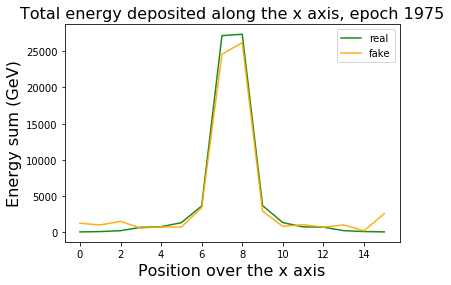

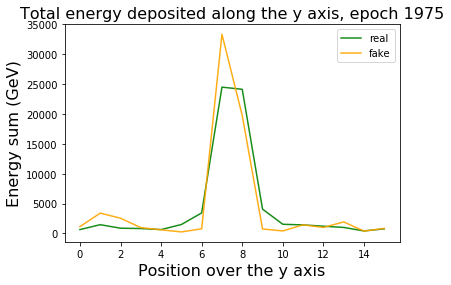

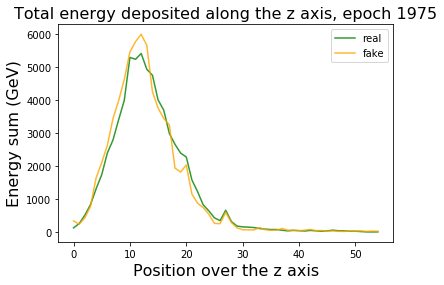

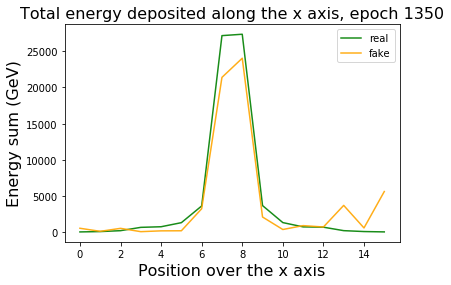

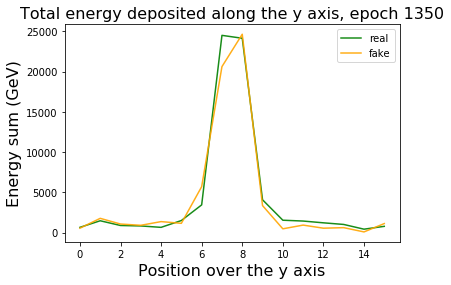

...

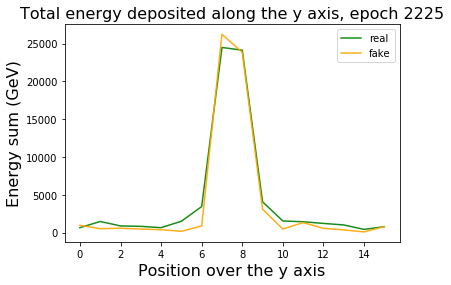

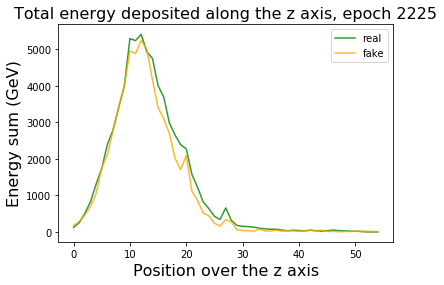

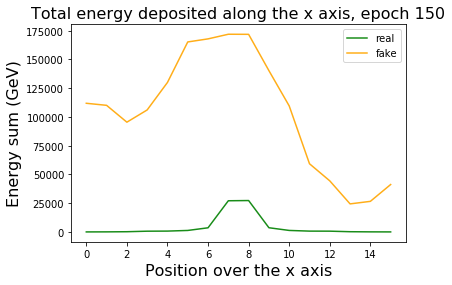

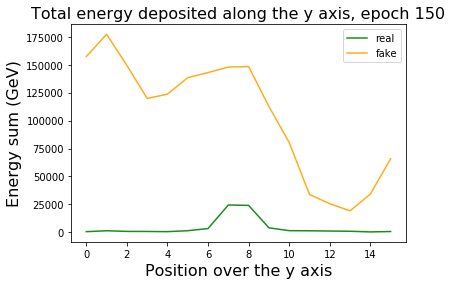

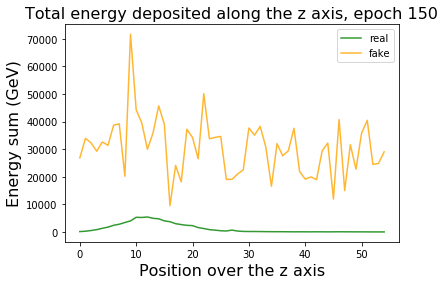

In [68]:
plotAxes(X[0:199], all_g_weight1, gen_model1)

Using TensorFlow backend.


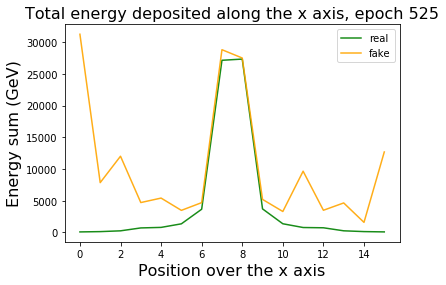

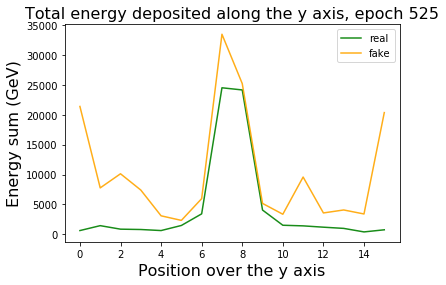

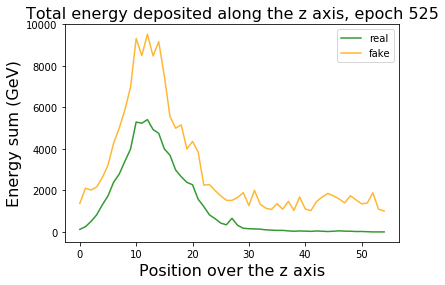

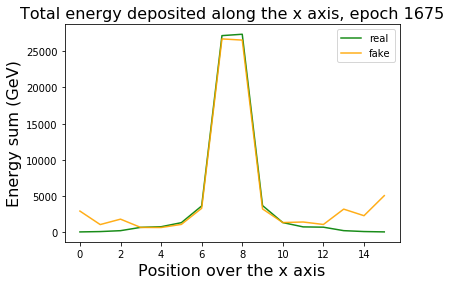

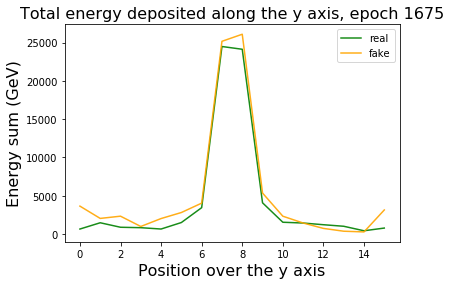

...

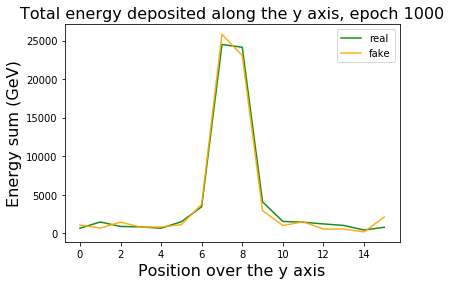

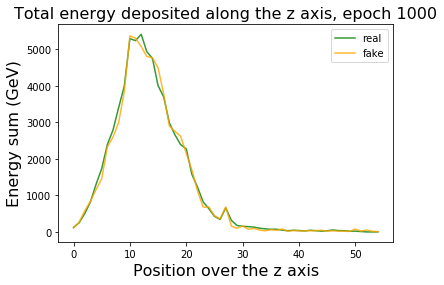

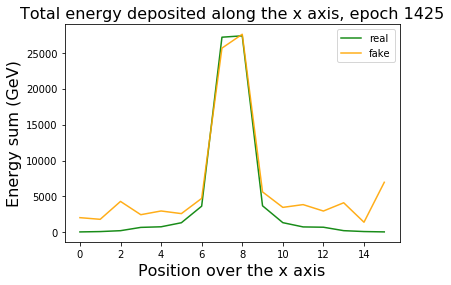

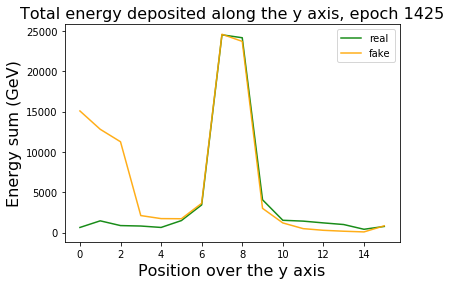

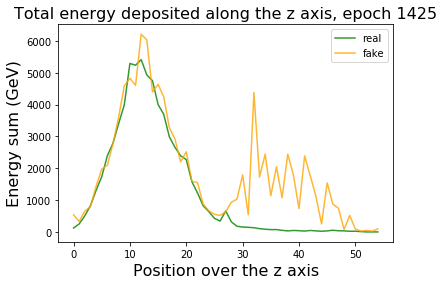

In [10]:
plotAxes(X[0:199], all_g_weight2, gen_model2)